# Torchvision Transforms Reference

Torchvision comes with a ton of transforms with different parameters that I've found to be difficult to understand. This is a reference guide I've found useful to refer to when developing computer vision models.

In [1]:
from torchvision import transforms
from PIL import Image
from visualizer import Visualizer # I built this as a nice helper to just draw some images in a grid

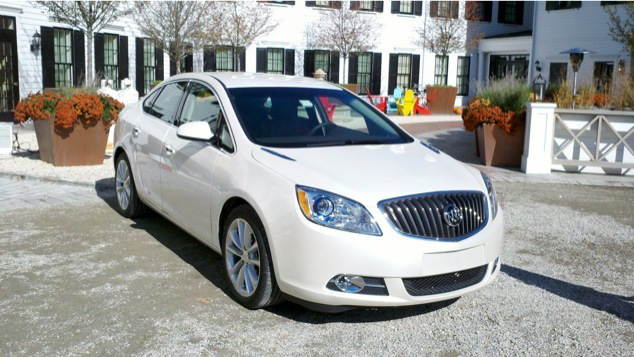

In [2]:
img = Image.open('car.jpg')
img

# Center Crop
```
Crops the given image at the center.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions.
    If image size is smaller than output size along any edge, image is padded with 0 and then center cropped.
    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made. If provided a sequence of length 1, it will be interpreted as (size[0], size[0]).
```

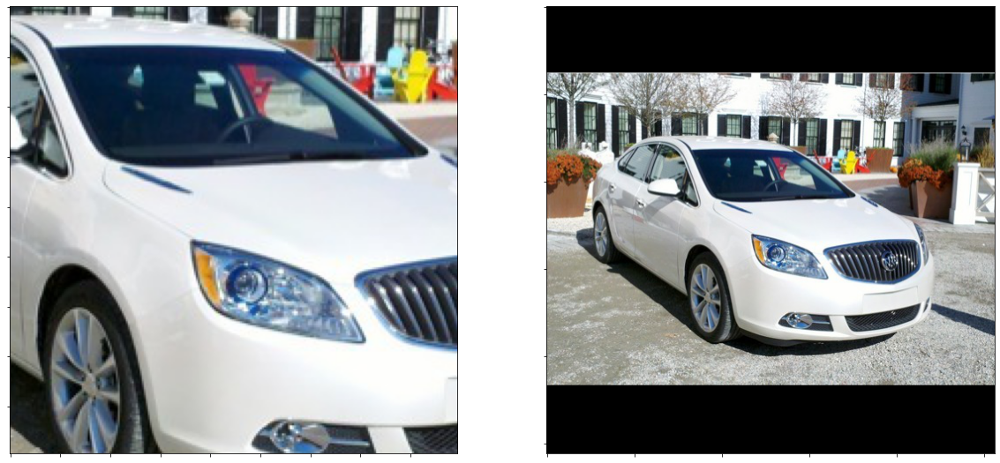

In [3]:
Visualizer(
    [
        transforms.CenterCrop(size=224)(img),
        transforms.CenterCrop(size=512)(img),
    ]
).visualize(figsize=(20, 20), cols=2, rows=1)

# ColorJitter

```
Randomly change the brightness, contrast, saturation and hue of an image.
    If the image is torch Tensor, it is expected
    to have [..., 3, H, W] shape, where ... means an arbitrary number of leading dimensions.
    If img is PIL Image, mode "1", "L", "I", "F" and modes with transparency (alpha channel) are not supported.
    Args:
        brightness (float or tuple of float (min, max)): How much to jitter brightness.
            brightness_factor is chosen uniformly from [max(0, 1 - brightness), 1 + brightness]
            or the given [min, max]. Should be non negative numbers.
        contrast (float or tuple of float (min, max)): How much to jitter contrast.
            contrast_factor is chosen uniformly from [max(0, 1 - contrast), 1 + contrast]
            or the given [min, max]. Should be non negative numbers.
        saturation (float or tuple of float (min, max)): How much to jitter saturation.
            saturation_factor is chosen uniformly from [max(0, 1 - saturation), 1 + saturation]
            or the given [min, max]. Should be non negative numbers.
        hue (float or tuple of float (min, max)): How much to jitter hue.
            hue_factor is chosen uniformly from [-hue, hue] or the given [min, max].
            Should have 0<= hue <= 0.5 or -0.5 <= min <= max <= 0.5.
```

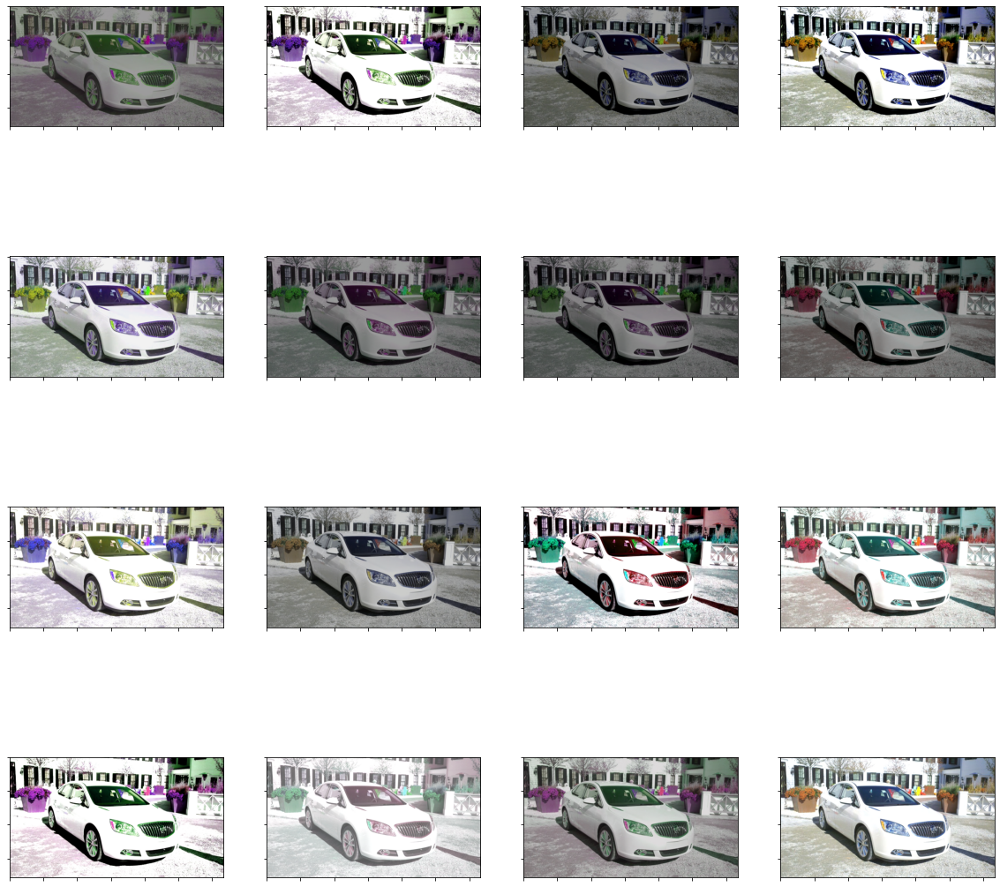

In [4]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.5)(x),
).visualize(figsize=(20, 20))

# Five Crop

```
Crop the given image into four corners and the central crop.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading
    dimensions
    .. Note::
         This transform returns a tuple of images and there may be a mismatch in the number of
         inputs and targets your Dataset returns. See below for an example of how to deal with
         this.
    Args:
         size (sequence or int): Desired output size of the crop. If size is an ``int``
            instead of sequence like (h, w), a square crop of size (size, size) is made.
            If provided a sequence of length 1, it will be interpreted as (size[0], size[0]).
    Example:
         >>> transform = Compose([
         >>>    FiveCrop(size), # this is a list of PIL Images
         >>>    Lambda(lambda crops: torch.stack([ToTensor()(crop) for crop in crops])) # returns a 4D tensor
         >>> ])
         >>> #In your test loop you can do the following:
         >>> input, target = batch # input is a 5d tensor, target is 2d
         >>> bs, ncrops, c, h, w = input.size()
         >>> result = model(input.view(-1, c, h, w)) # fuse batch size and ncrops
         >>> result_avg = result.view(bs, ncrops, -1).mean(1) # avg over crops
```

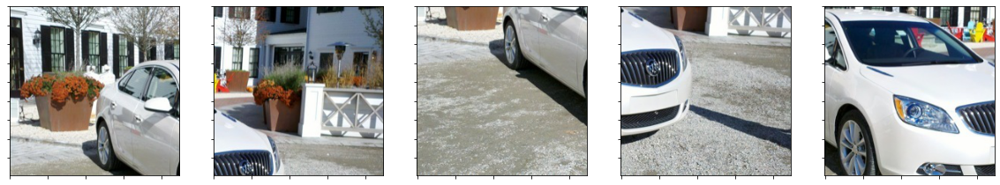

In [5]:
Visualizer(
    transforms.FiveCrop(size=(224, 224))(img),
).visualize(figsize=(20, 20), rows=1, cols=5)

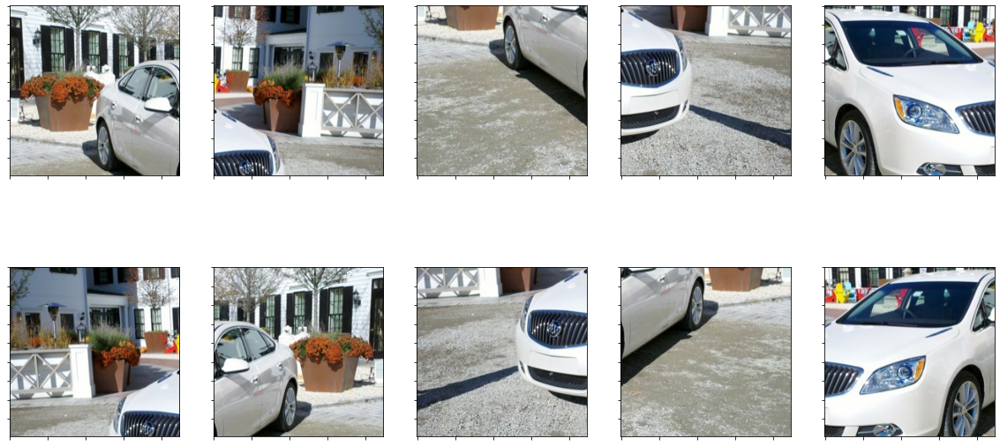

In [7]:
Visualizer(
    transforms.TenCrop(size=(224, 224))(img),
).visualize(figsize=(20, 10), rows=2, cols=5)

# Grayscale

```
Convert image to grayscale.
    If the image is torch Tensor, it is expected
    to have [..., 3, H, W] shape, where ... means an arbitrary number of leading dimensions
    Args:
        num_output_channels (int): (1 or 3) number of channels desired for output image
    Returns:
        PIL Image: Grayscale version of the input.
         - If ``num_output_channels == 1`` : returned image is single channel
         - If ``num_output_channels == 3`` : returned image is 3 channel with r == g == b
```

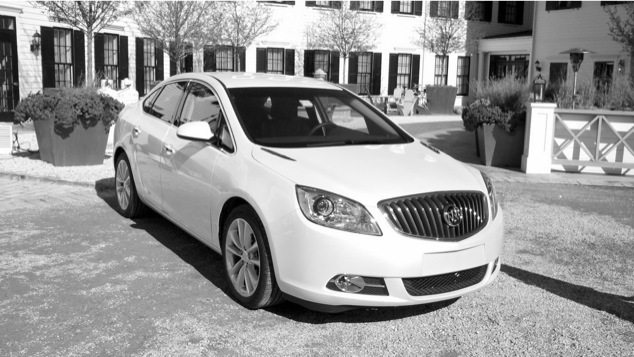

In [10]:
transforms.Grayscale(num_output_channels=1)(img)

# Pad

```
Pad the given image on all sides with the given "pad" value.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means at most 2 leading dimensions for mode reflect and symmetric,
    at most 3 leading dimensions for mode edge,
    and an arbitrary number of leading dimensions for mode constant
    Args:
        padding (int or sequence): Padding on each border. If a single int is provided this
            is used to pad all borders. If sequence of length 2 is provided this is the padding
            on left/right and top/bottom respectively. If a sequence of length 4 is provided
            this is the padding for the left, top, right and bottom borders respectively.
            In torchscript mode padding as single int is not supported, use a sequence of length 1: ``[padding, ]``.
        fill (number or str or tuple): Pixel fill value for constant fill. Default is 0. If a tuple of
            length 3, it is used to fill R, G, B channels respectively.
            This value is only used when the padding_mode is constant.
            Only number is supported for torch Tensor.
            Only int or str or tuple value is supported for PIL Image.
        padding_mode (str): Type of padding. Should be: constant, edge, reflect or symmetric.
            Default is constant.
            - constant: pads with a constant value, this value is specified with fill
            - edge: pads with the last value at the edge of the image,
                    if input a 5D torch Tensor, the last 3 dimensions will be padded instead of the last 2
            - reflect: pads with reflection of image without repeating the last value on the edge
                For example, padding [1, 2, 3, 4] with 2 elements on both sides in reflect mode
                will result in [3, 2, 1, 2, 3, 4, 3, 2]
            - symmetric: pads with reflection of image repeating the last value on the edge
                For example, padding [1, 2, 3, 4] with 2 elements on both sides in symmetric mode
                will result in [2, 1, 1, 2, 3, 4, 4, 3]
```

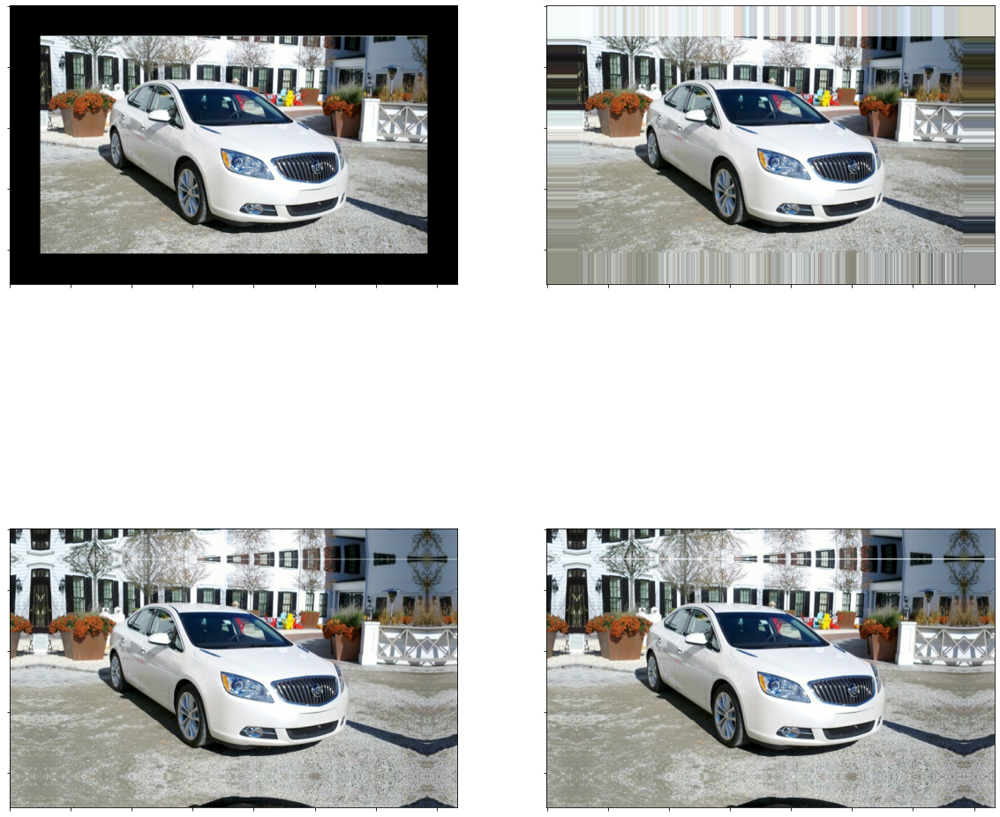

In [12]:
import itertools
Visualizer(
    [
        transforms.Pad(50, fill=0, padding_mode='constant')(img),
        transforms.Pad(50, fill=0, padding_mode='edge')(img),
        transforms.Pad(50, fill=0, padding_mode='reflect')(img),
        transforms.Pad(50, fill=0, padding_mode='symmetric')(img),
    ]
).visualize(rows=2, cols=2, figsize=(20, 20), sample=False)


# RandomAffine

```
Random affine transformation of the image keeping center invariant.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions.
    Args:
        degrees (sequence or number): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees). Set to 0 to deactivate rotations.
        translate (tuple, optional): tuple of maximum absolute fraction for horizontal
            and vertical translations. For example translate=(a, b), then horizontal shift
            is randomly sampled in the range -img_width * a < dx < img_width * a and vertical shift is
            randomly sampled in the range -img_height * b < dy < img_height * b. Will not translate by default.
        scale (tuple, optional): scaling factor interval, e.g (a, b), then scale is
            randomly sampled from the range a <= scale <= b. Will keep original scale by default.
        shear (sequence or number, optional): Range of degrees to select from.
            If shear is a number, a shear parallel to the x axis in the range (-shear, +shear)
            will be applied. Else if shear is a sequence of 2 values a shear parallel to the x axis in the
            range (shear[0], shear[1]) will be applied. Else if shear is a sequence of 4 values,
            a x-axis shear in (shear[0], shear[1]) and y-axis shear in (shear[2], shear[3]) will be applied.
            Will not apply shear by default.
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.NEAREST``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
        fill (sequence or number): Pixel fill value for the area outside the transformed
            image. Default is ``0``. If given a number, the value is used for all bands respectively.
            If input is PIL Image, the options is only available for ``Pillow>=5.0.0``.
        fillcolor (sequence or number, optional): deprecated argument and will be removed since v0.10.0.
            Please use the ``fill`` parameter instead.
        resample (int, optional): deprecated argument and will be removed since v0.10.0.
            Please use the ``interpolation`` parameter instead.
```

### Random Affine with just a degrees parameter

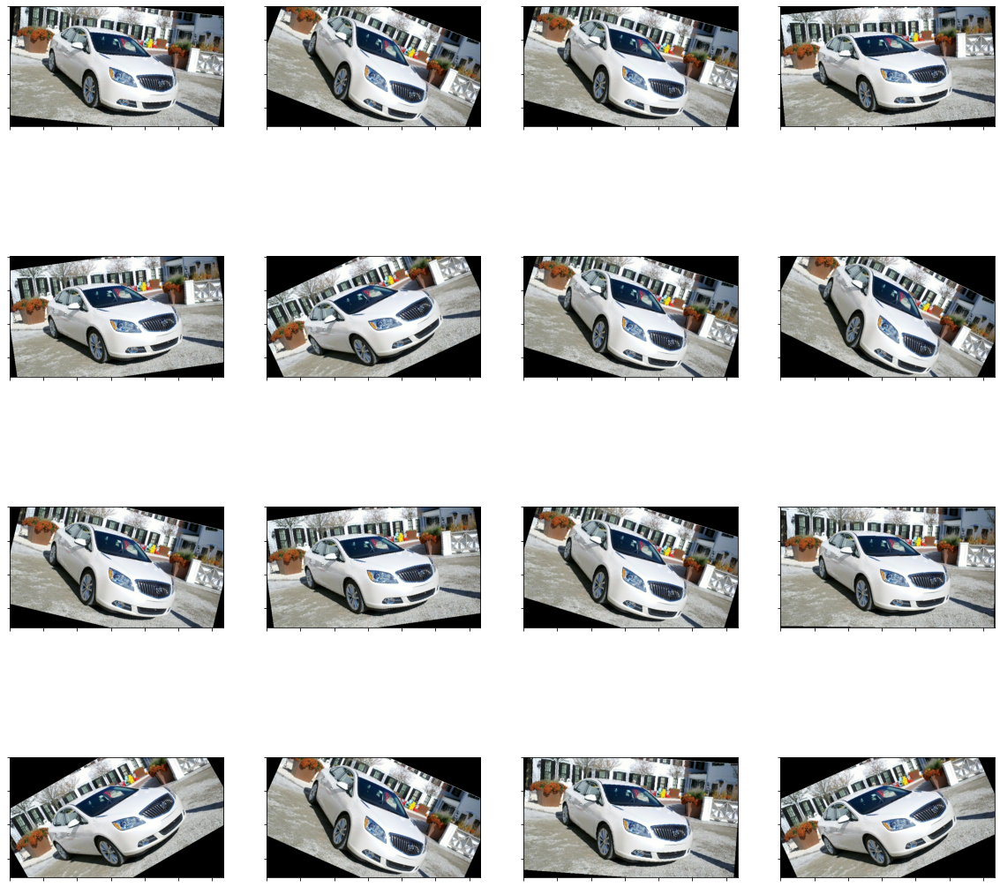

In [14]:
Visualizer(
    [img] * 16,
    image_extractor=lambda x: transforms.RandomAffine(30)(x),
).visualize(figsize=(20, 20))

### Random Affine with a translate parameter

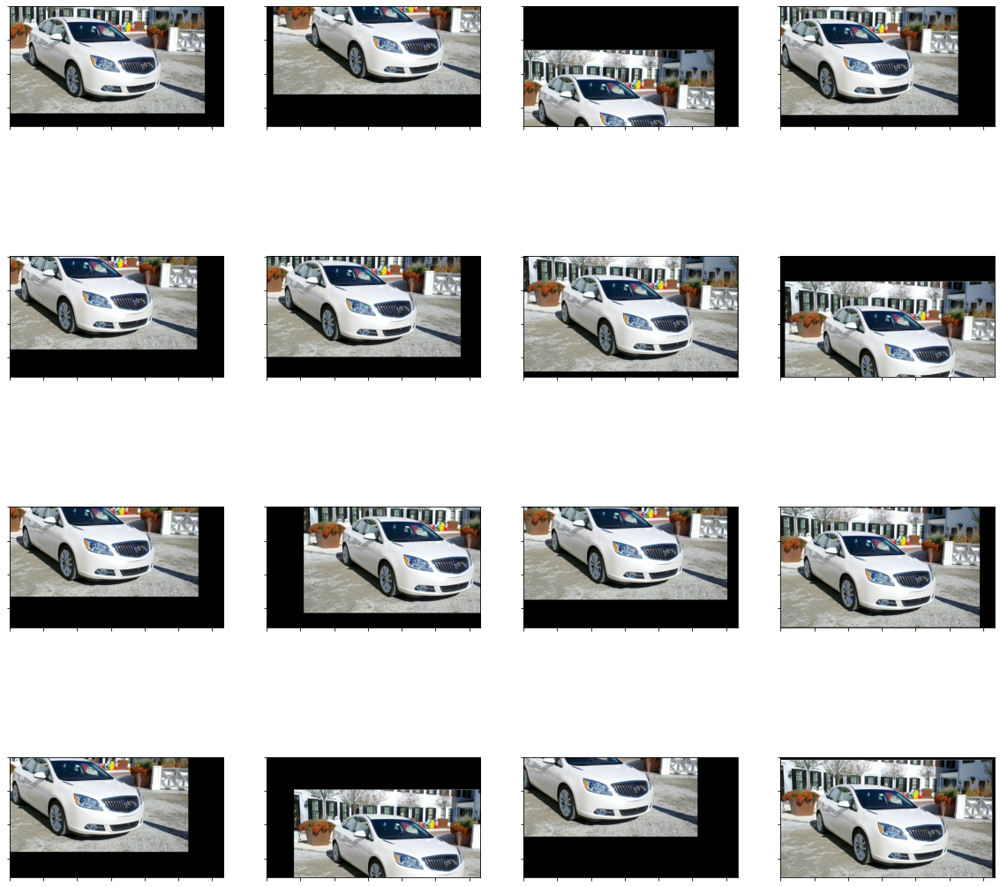

In [15]:
Visualizer(
    [img] * 16,
    image_extractor=lambda x: transforms.RandomAffine(0, translate=(0.2, 0.4))(x),
).visualize(figsize=(20, 20))

### Random Affine with a scale parameter

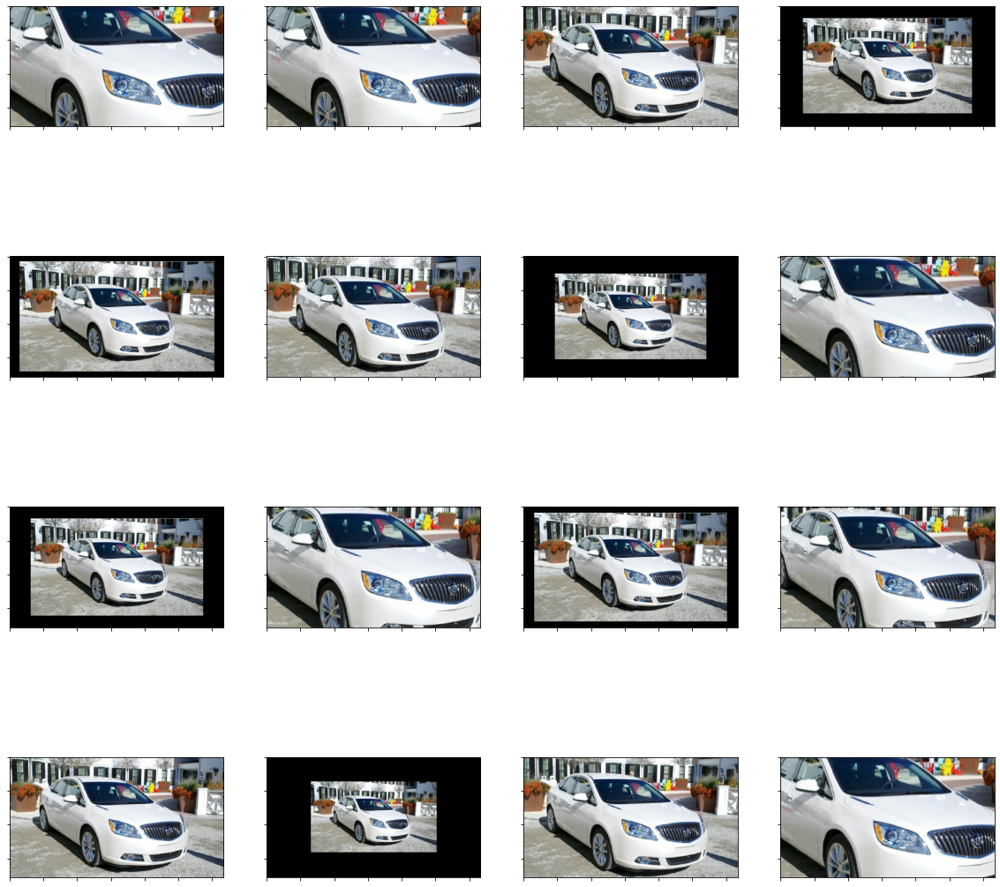

In [16]:
Visualizer(
    [img] * 16,
    image_extractor=lambda x: transforms.RandomAffine(0, scale=(0.5, 2.0))(x),
).visualize(figsize=(20, 20))

### Random Affine with a schear parameter

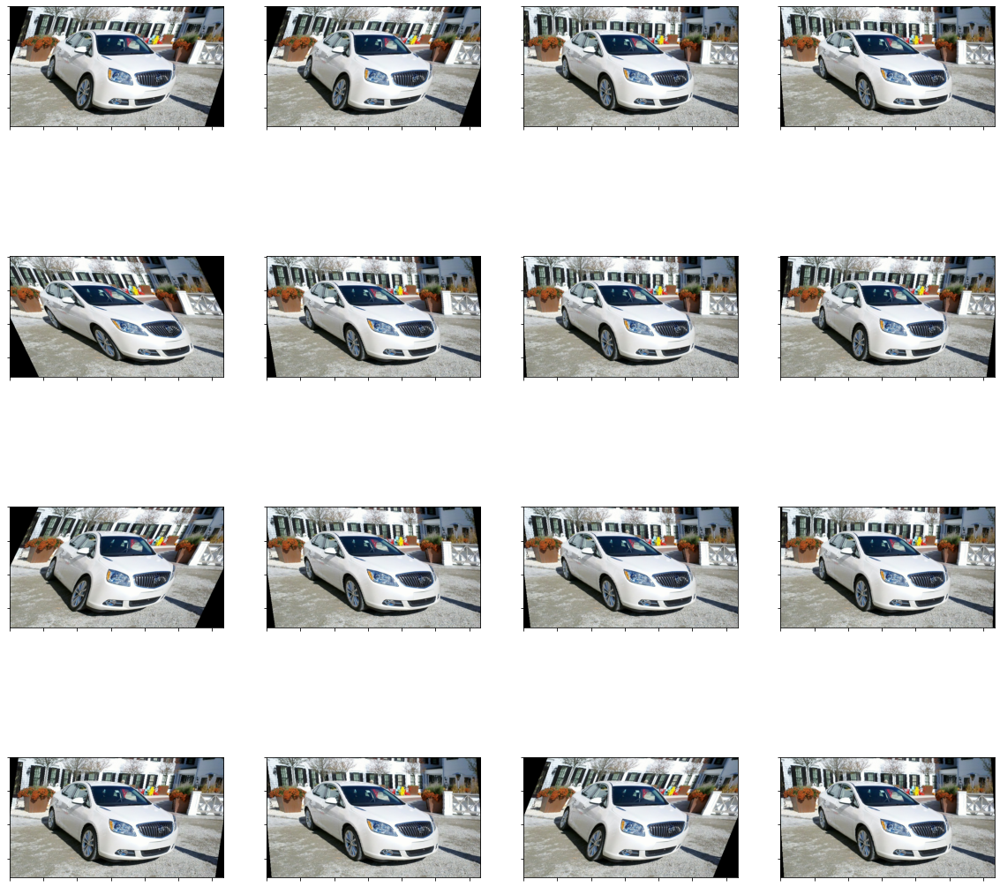

In [17]:
Visualizer(
    [img] * 16,
    image_extractor=lambda x: transforms.RandomAffine(0, shear=(-30, 30))(x),
).visualize(figsize=(20, 20))

### Random Affine all together

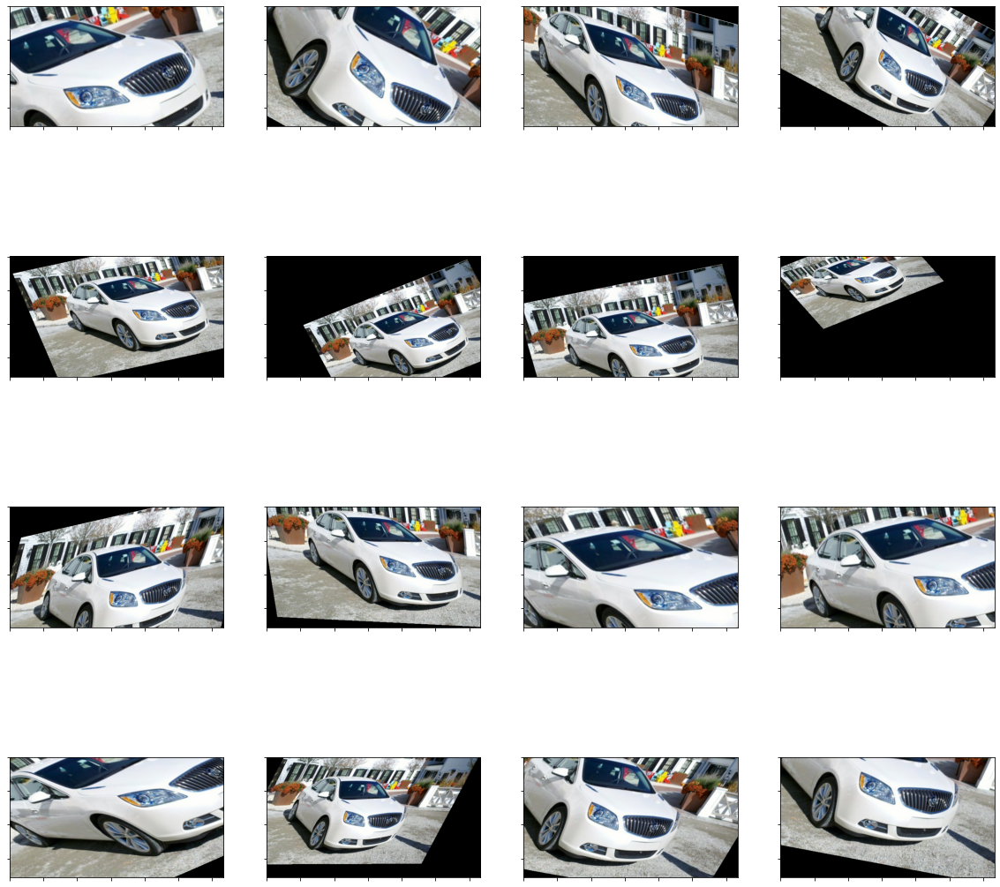

In [19]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomAffine(
        30,
        translate=(0.2, 0.4),
        scale=(0.5, 2.0),
        shear=(-30, 30),
        resample=Image.BILINEAR,
        fillcolor=0,
    )(x),
).visualize(figsize=(20, 20))

# Random Crop

```
Crop the given image at a random location.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions,
    but if non-constant padding is used, the input is expected to have at most 2 leading dimensions
    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made. If provided a sequence of length 1, it will be interpreted as (size[0], size[0]).
        padding (int or sequence, optional): Optional padding on each border
            of the image. Default is None. If a single int is provided this
            is used to pad all borders. If sequence of length 2 is provided this is the padding
            on left/right and top/bottom respectively. If a sequence of length 4 is provided
            this is the padding for the left, top, right and bottom borders respectively.
            In torchscript mode padding as single int is not supported, use a sequence of length 1: ``[padding, ]``.
        pad_if_needed (boolean): It will pad the image if smaller than the
            desired size to avoid raising an exception. Since cropping is done
            after padding, the padding seems to be done at a random offset.
        fill (number or str or tuple): Pixel fill value for constant fill. Default is 0. If a tuple of
            length 3, it is used to fill R, G, B channels respectively.
            This value is only used when the padding_mode is constant.
            Only number is supported for torch Tensor.
            Only int or str or tuple value is supported for PIL Image.
        padding_mode (str): Type of padding. Should be: constant, edge, reflect or symmetric. Default is constant.
             - constant: pads with a constant value, this value is specified with fill
             - edge: pads with the last value on the edge of the image
             - reflect: pads with reflection of image (without repeating the last value on the edge)
                padding [1, 2, 3, 4] with 2 elements on both sides in reflect mode
                will result in [3, 2, 1, 2, 3, 4, 3, 2]
             - symmetric: pads with reflection of image (repeating the last value on the edge)
                padding [1, 2, 3, 4] with 2 elements on both sides in symmetric mode
                will result in [2, 1, 1, 2, 3, 4, 4, 3]
```

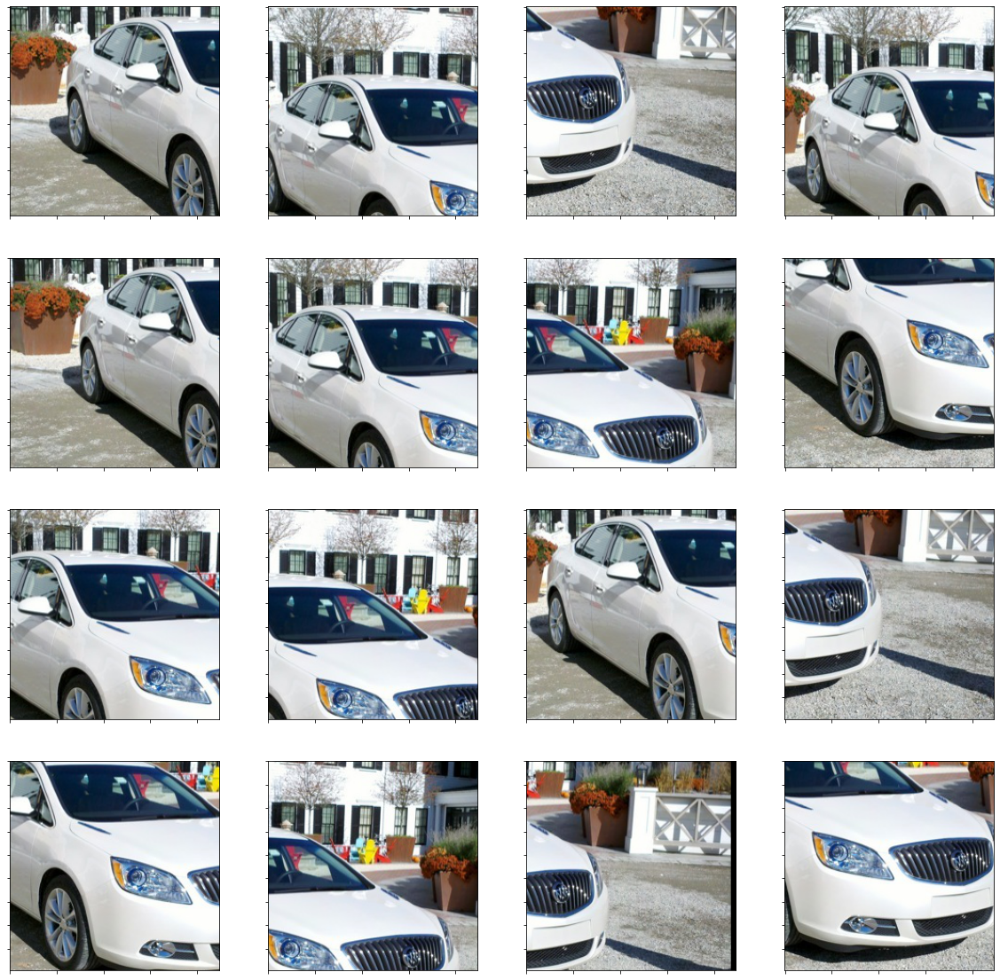

In [20]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomCrop(224, padding=10, pad_if_needed=False)(x),
).visualize(figsize=(20, 20))

# Random Grayscale

```
Crop the given image at a random location.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions,
    but if non-constant padding is used, the input is expected to have at most 2 leading dimensions
    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made. If provided a sequence of length 1, it will be interpreted as (size[0], size[0]).
        padding (int or sequence, optional): Optional padding on each border
            of the image. Default is None. If a single int is provided this
            is used to pad all borders. If sequence of length 2 is provided this is the padding
            on left/right and top/bottom respectively. If a sequence of length 4 is provided
            this is the padding for the left, top, right and bottom borders respectively.
            In torchscript mode padding as single int is not supported, use a sequence of length 1: ``[padding, ]``.
        pad_if_needed (boolean): It will pad the image if smaller than the
            desired size to avoid raising an exception. Since cropping is done
            after padding, the padding seems to be done at a random offset.
        fill (number or str or tuple): Pixel fill value for constant fill. Default is 0. If a tuple of
            length 3, it is used to fill R, G, B channels respectively.
            This value is only used when the padding_mode is constant.
            Only number is supported for torch Tensor.
            Only int or str or tuple value is supported for PIL Image.
        padding_mode (str): Type of padding. Should be: constant, edge, reflect or symmetric. Default is constant.
             - constant: pads with a constant value, this value is specified with fill
             - edge: pads with the last value on the edge of the image
             - reflect: pads with reflection of image (without repeating the last value on the edge)
                padding [1, 2, 3, 4] with 2 elements on both sides in reflect mode
                will result in [3, 2, 1, 2, 3, 4, 3, 2]
             - symmetric: pads with reflection of image (repeating the last value on the edge)
                padding [1, 2, 3, 4] with 2 elements on both sides in symmetric mode
                will result in [2, 1, 1, 2, 3, 4, 4, 3]
```

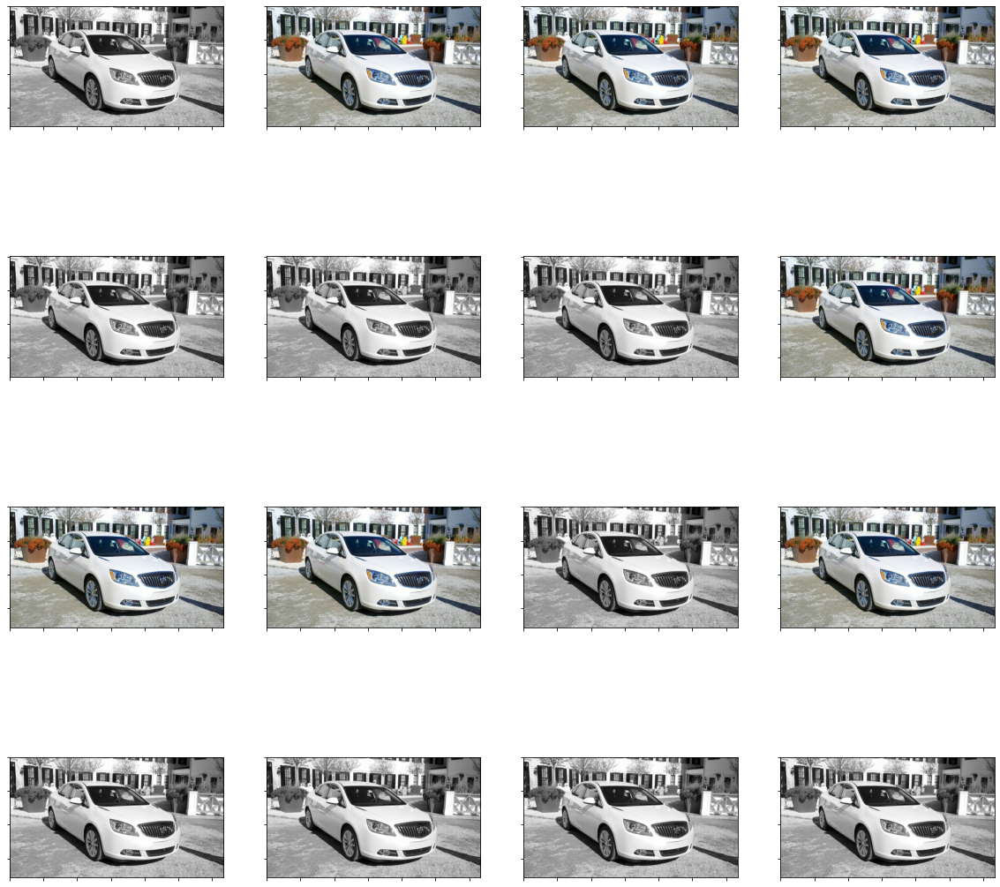

In [21]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomGrayscale(p=0.5)(x),
).visualize(figsize=(20, 20))

# Random Horizontal Flip

```
Horizontally flip the given image randomly with a given probability.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading
    dimensions
    Args:
        p (float): probability of the image being flipped. Default value is 0.5
```

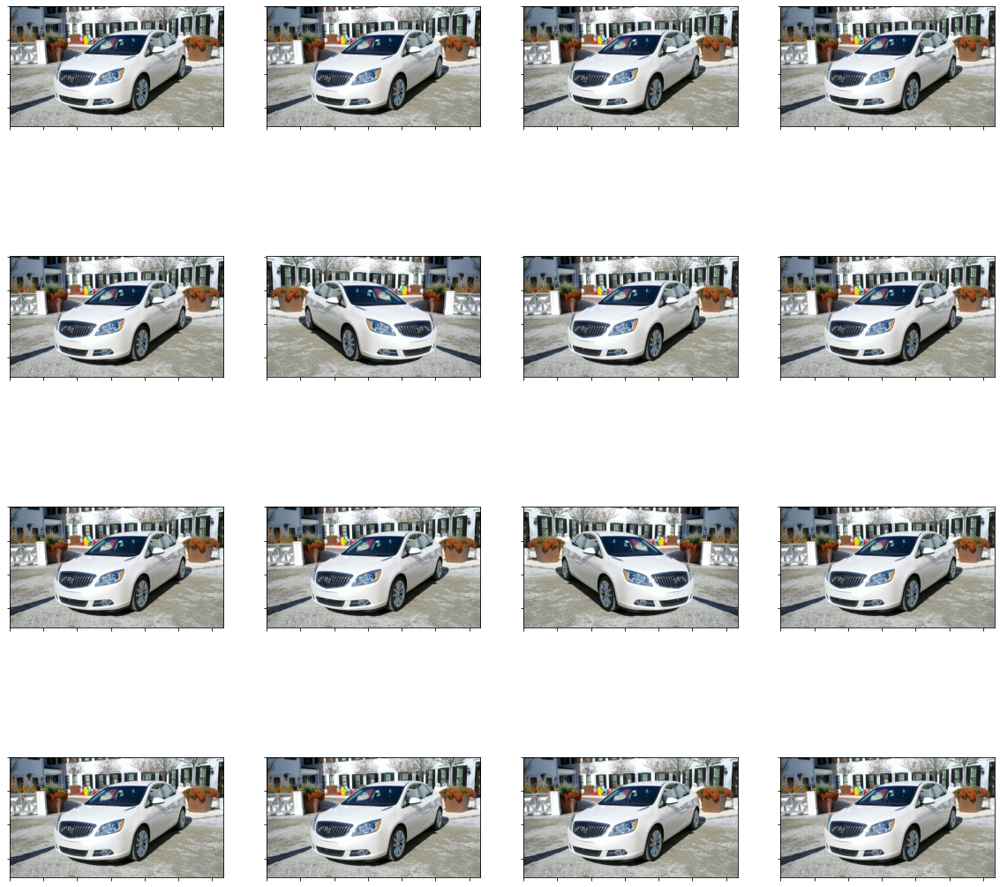

In [22]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomHorizontalFlip(p=0.90)(x),
).visualize(figsize=(20, 20))

# Random Vertical Flip

```
Vertically flip the given image randomly with a given probability.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading
    dimensions
    Args:
        p (float): probability of the image being flipped. Default value is 0.5
```

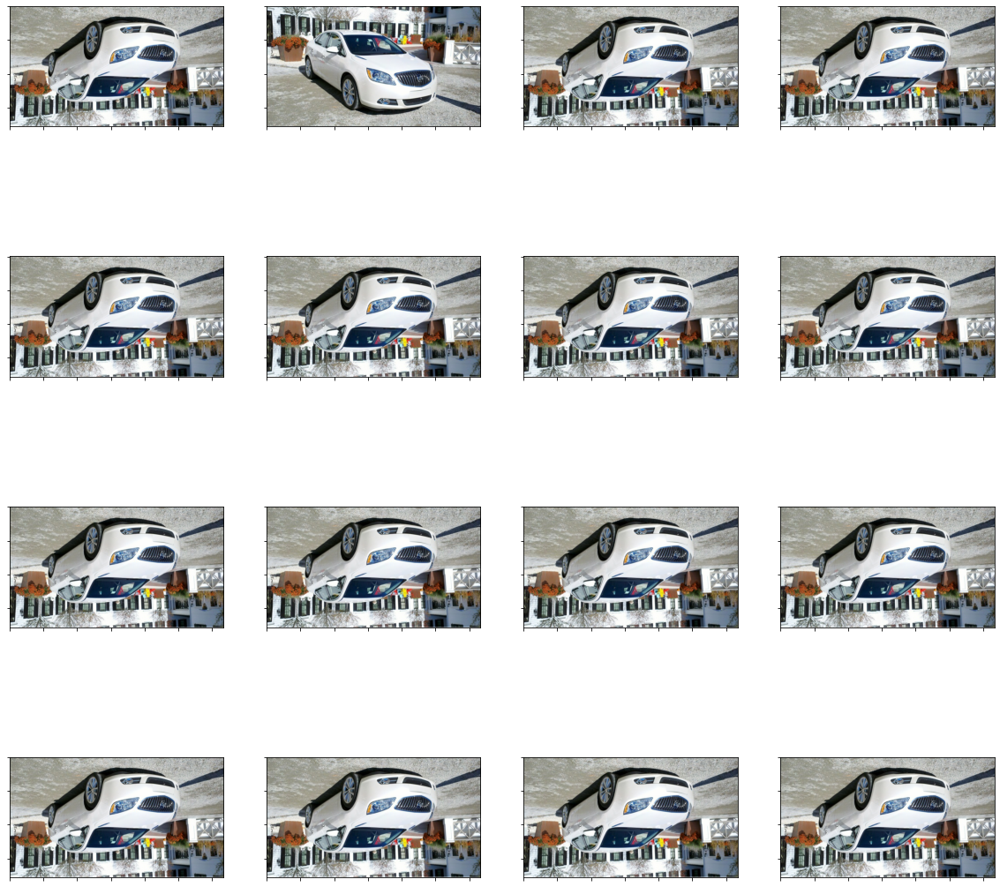

In [23]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomVerticalFlip(p=0.90)(x),
).visualize(figsize=(20, 20))

# Random Resized Crop

```
Crop the given image to random size and aspect ratio.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions
    A crop of random size (default: of 0.08 to 1.0) of the original size and a random
    aspect ratio (default: of 3/4 to 4/3) of the original aspect ratio is made. This crop
    is finally resized to given size.
    This is popularly used to train the Inception networks.
    Args:
        size (int or sequence): expected output size of each edge. If size is an
            int instead of sequence like (h, w), a square output size ``(size, size)`` is
            made. If provided a sequence of length 1, it will be interpreted as (size[0], size[0]).
            In torchscript mode size as single int is not supported, use a sequence of length 1: ``[size, ]``.
        scale (tuple of float): scale range of the cropped image before resizing, relatively to the origin image.
        ratio (tuple of float): aspect ratio range of the cropped image before resizing.
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.BILINEAR``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` and
            ``InterpolationMode.BICUBIC`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
```

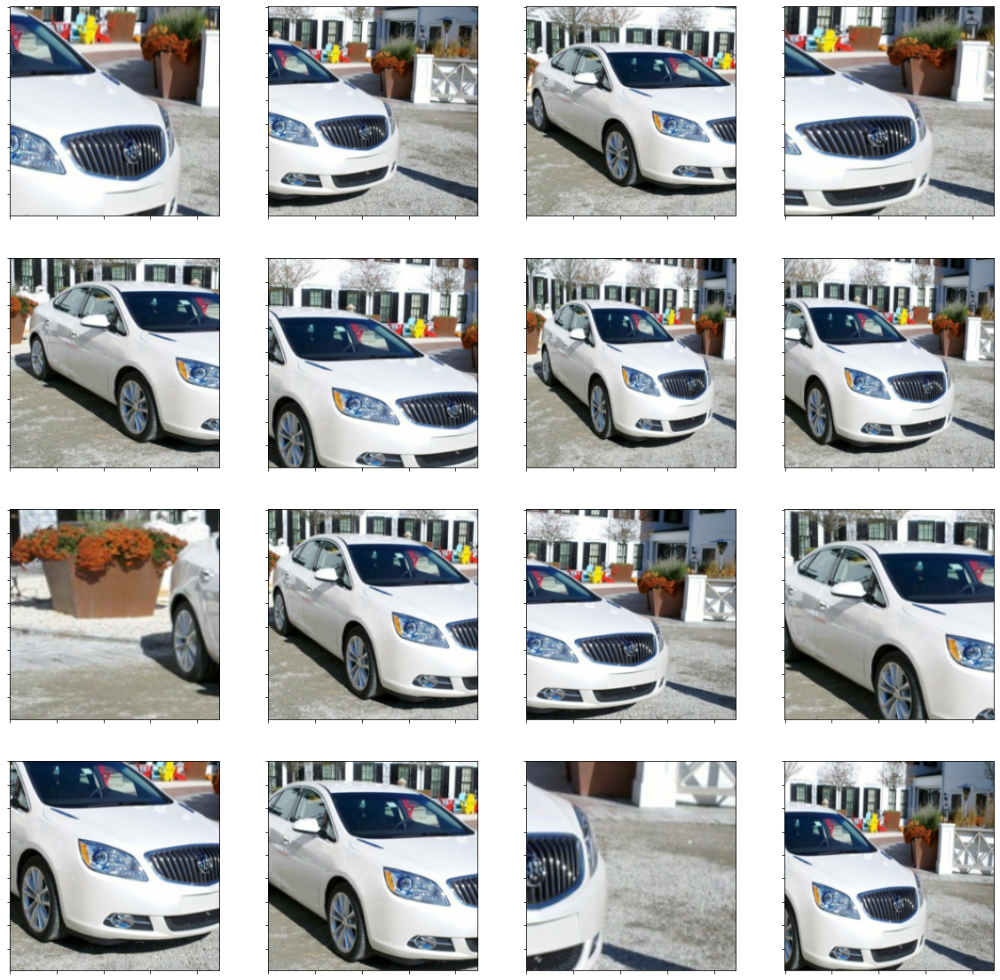

In [24]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomResizedCrop(224, scale=(0.08, 2.0))(x),
).visualize(figsize=(20, 20))

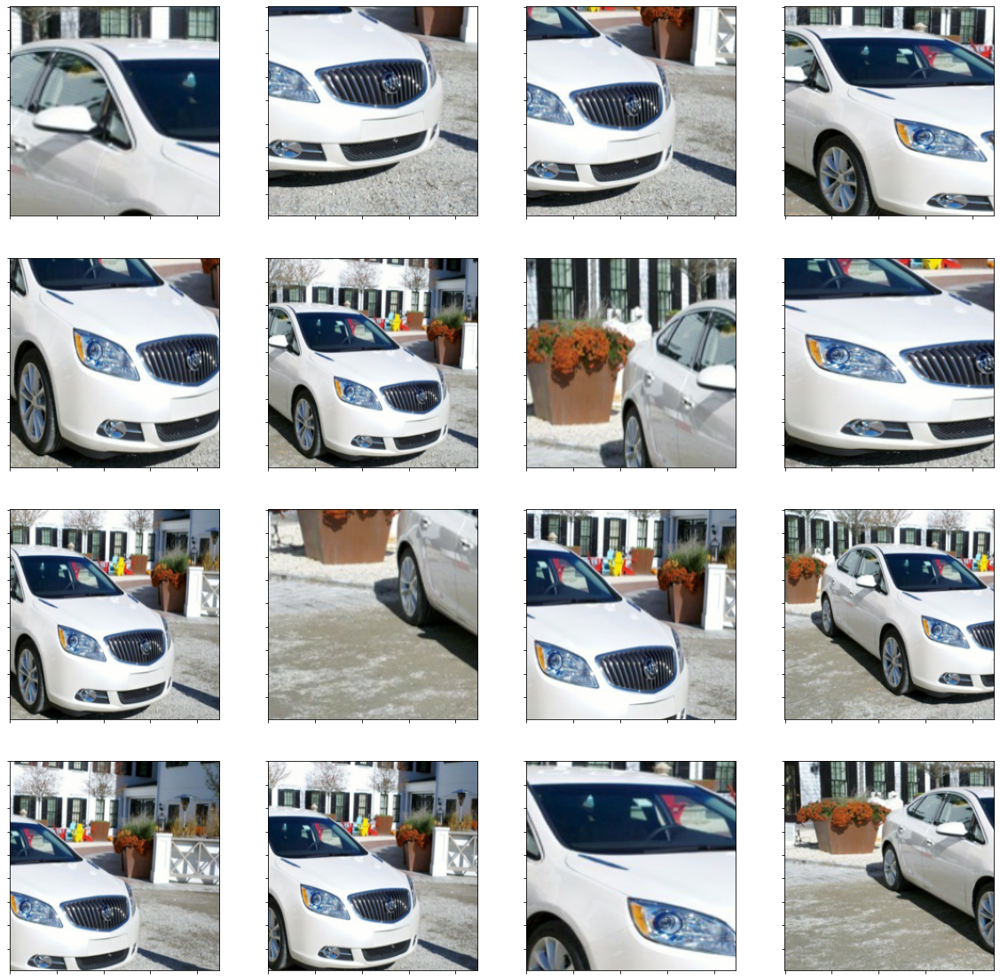

In [25]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomResizedCrop(224, ratio=(0.75, 1.3333333333333333), interpolation=2)(x),
).visualize(figsize=(20, 20))

# Random Rotation
```
Rotate the image by angle.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions.
    Args:
        degrees (sequence or number): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees).
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.NEAREST``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
        expand (bool, optional): Optional expansion flag.
            If true, expands the output to make it large enough to hold the entire rotated image.
            If false or omitted, make the output image the same size as the input image.
            Note that the expand flag assumes rotation around the center and no translation.
        center (sequence, optional): Optional center of rotation, (x, y). Origin is the upper left corner.
            Default is the center of the image.
        fill (sequence or number): Pixel fill value for the area outside the rotated
            image. Default is ``0``. If given a number, the value is used for all bands respectively.
            If input is PIL Image, the options is only available for ``Pillow>=5.2.0``.
        resample (int, optional): deprecated argument and will be removed since v0.10.0.
            Please use the ``interpolation`` parameter instead.
```

### Random Rotation with just degrees parameter

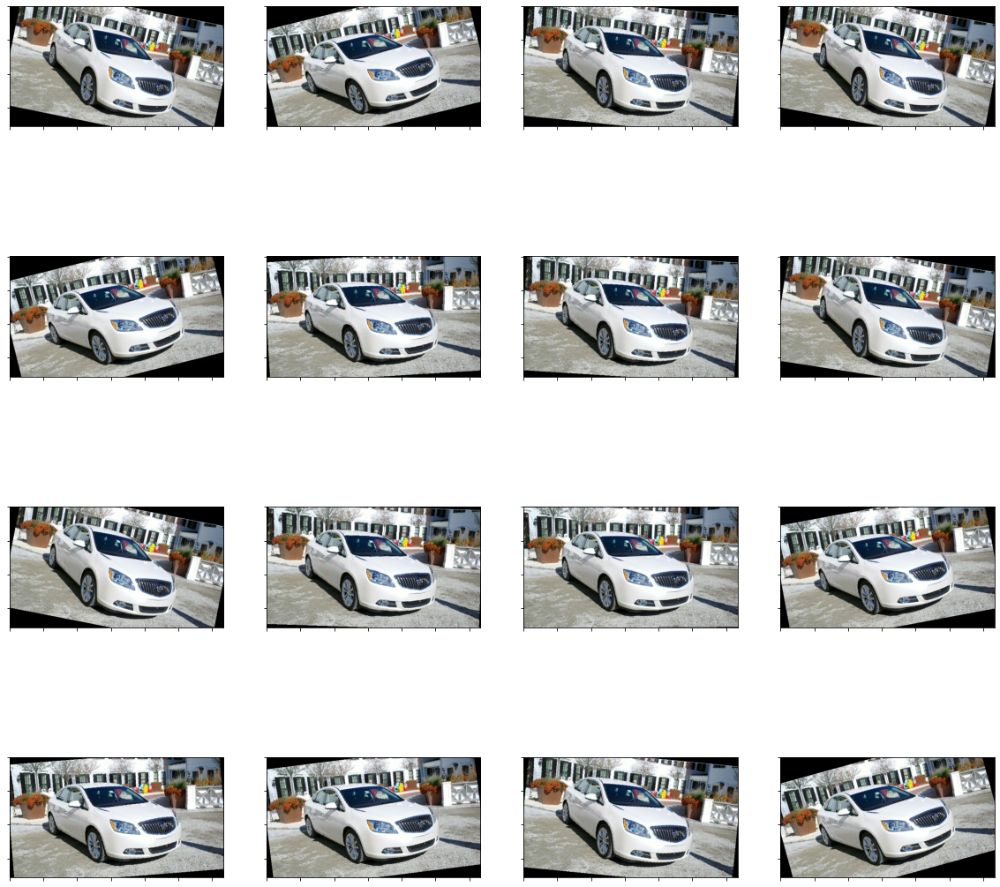

In [26]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomRotation(20)(x),
).visualize(figsize=(20, 20))

### Random Rotation with `expand = True`

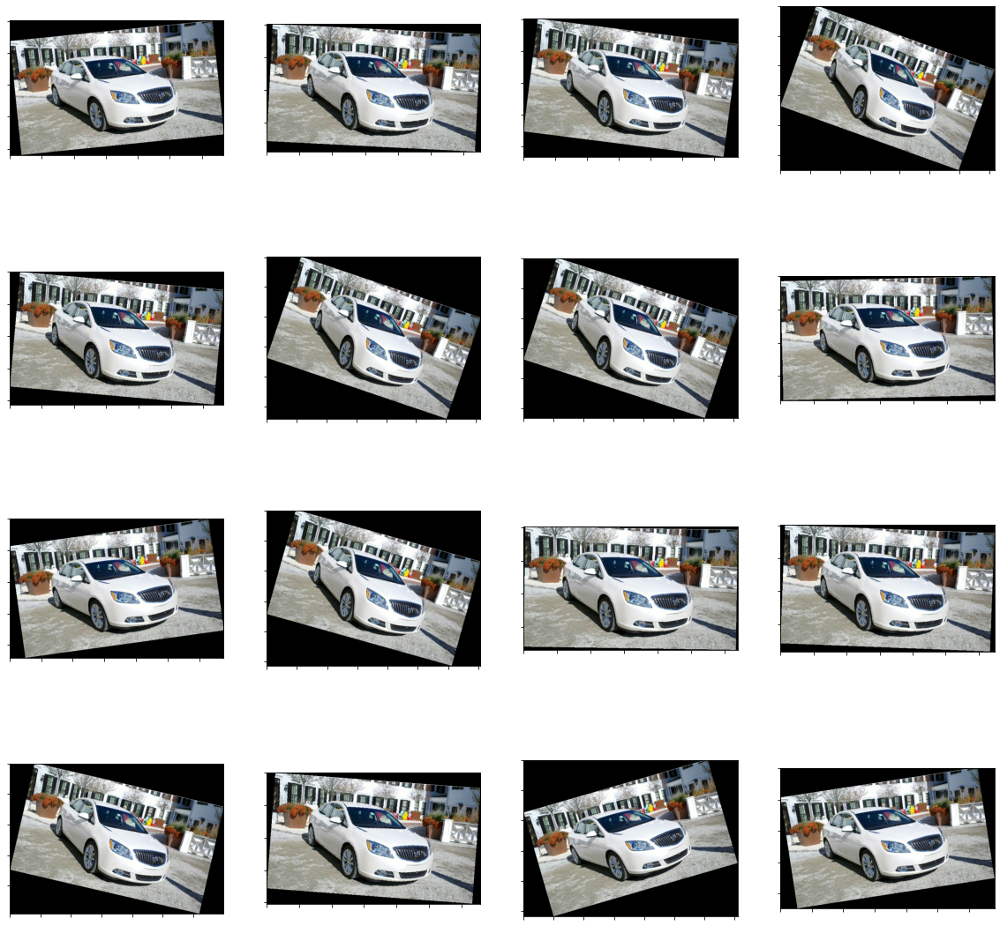

In [27]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomRotation(20, expand=True)(x),
).visualize(figsize=(20, 20))

### Random Rotation around `center = (0,0)`

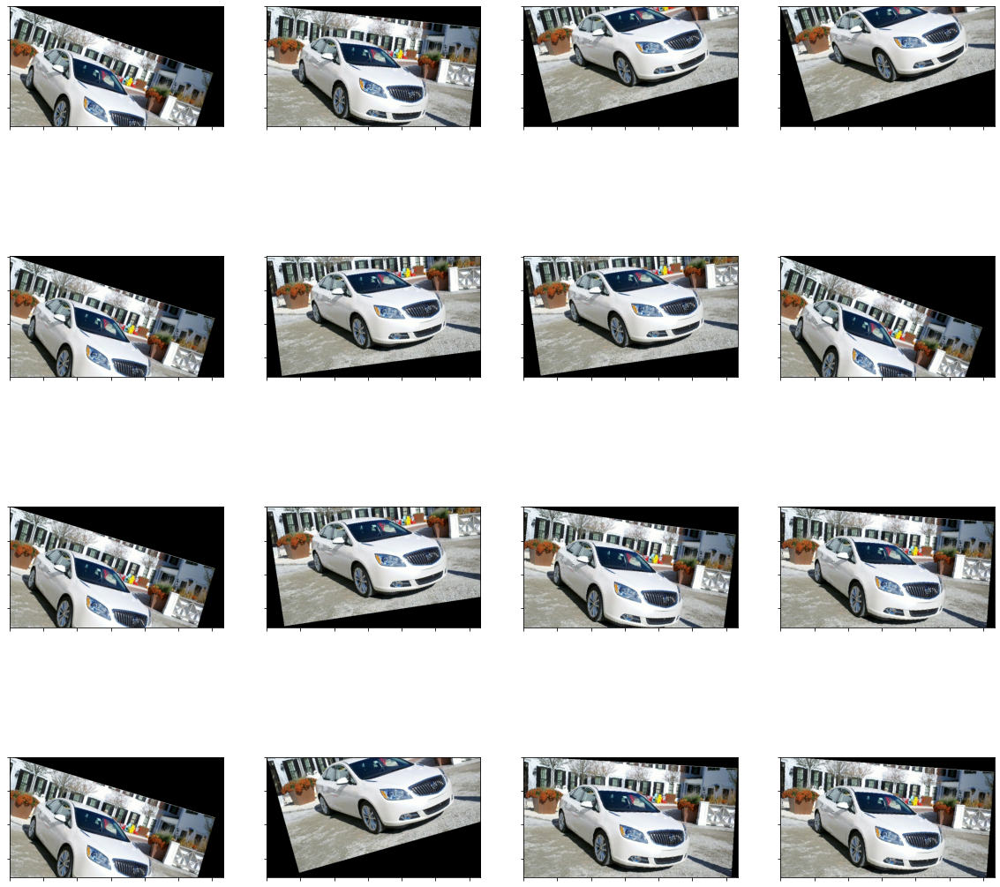

In [31]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomRotation(20, expand=False, center=(0,0))(x),
).visualize(figsize=(20, 20))

In [32]:
# Random Perspective

```
Performs a random perspective transformation of the given image with a given probability.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions.
    Args:
        distortion_scale (float): argument to control the degree of distortion and ranges from 0 to 1.
            Default is 0.5.
        p (float): probability of the image being transformed. Default is 0.5.
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.BILINEAR``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
        fill (sequence or number): Pixel fill value for the area outside the transformed
            image. Default is ``0``. If given a number, the value is used for all bands respectively.
            If input is PIL Image, the options is only available for ``Pillow>=5.0.0``.
```

SyntaxError: invalid syntax (<ipython-input-32-f8cfc5e0dc67>, line 3)

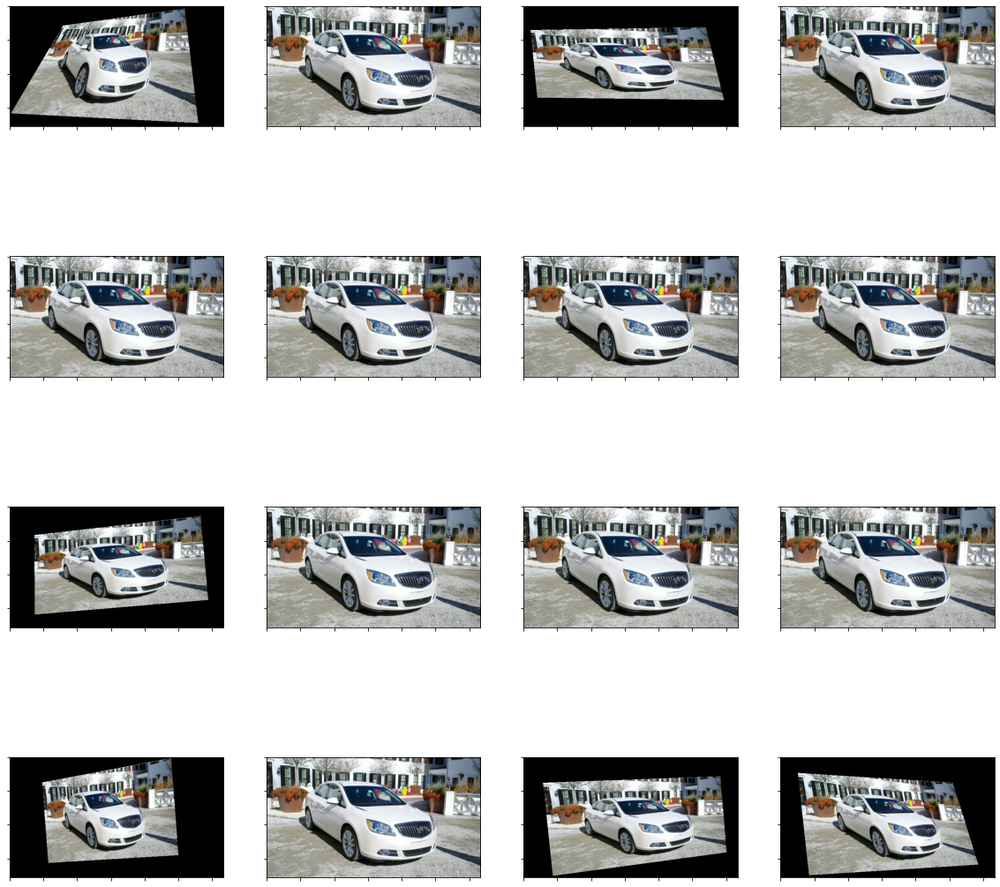

In [33]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomPerspective(distortion_scale=0.5, p=0.5, interpolation=2, fill=0)(x),
).visualize(figsize=(20, 20))

# Random Rotation
```
"Rotate the image by angle.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions.
    Args:
        degrees (sequence or number): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees).
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.NEAREST``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
        expand (bool, optional): Optional expansion flag.
            If true, expands the output to make it large enough to hold the entire rotated image.
            If false or omitted, make the output image the same size as the input image.
            Note that the expand flag assumes rotation around the center and no translation.
        center (sequence, optional): Optional center of rotation, (x, y). Origin is the upper left corner.
            Default is the center of the image.
        fill (sequence or number): Pixel fill value for the area outside the rotated
            image. Default is ``0``. If given a number, the value is used for all bands respectively.
            If input is PIL Image, the options is only available for ``Pillow>=5.2.0``.
        resample (int, optional): deprecated argument and will be removed since v0.10.0.
            Please use the ``interpolation`` parameter instead.
```

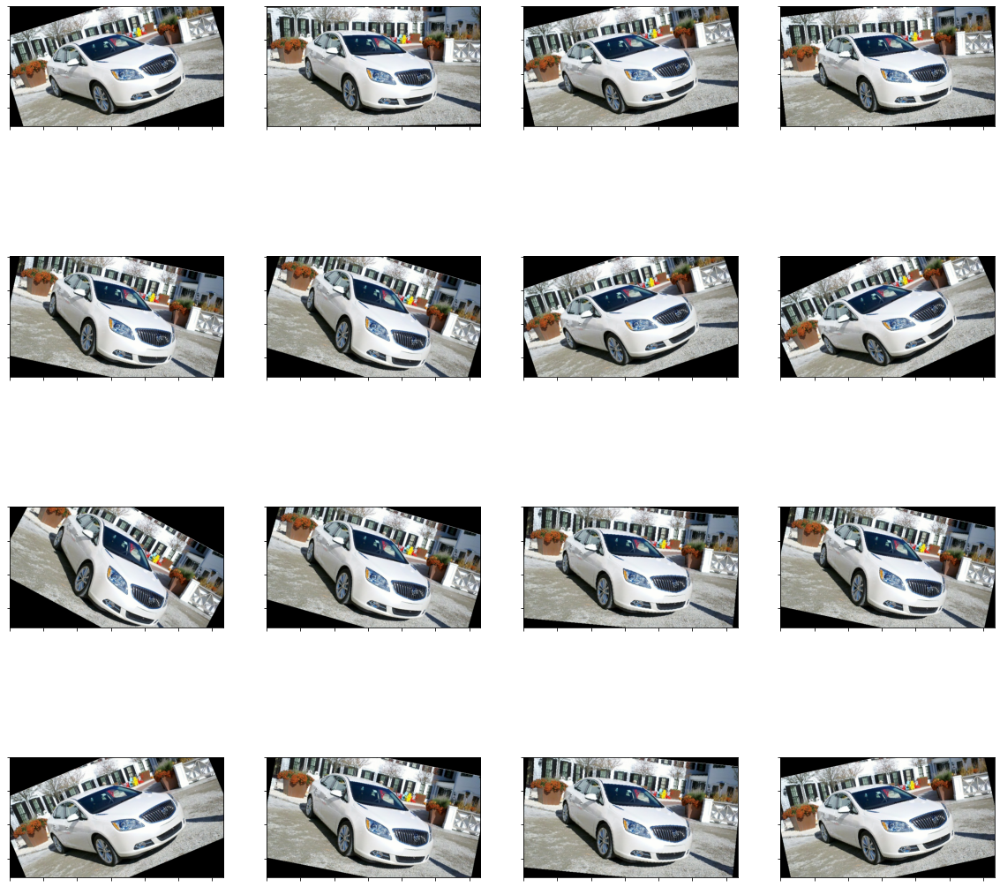

In [34]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.RandomRotation(degrees=30)(x),
).visualize(figsize=(20, 20))

# Gaussian Blur

```
Blurs image with randomly chosen Gaussian blur.
    If the image is torch Tensor, it is expected
    to have [..., C, H, W] shape, where ... means an arbitrary number of leading dimensions.
    Args:
        kernel_size (int or sequence): Size of the Gaussian kernel.
        sigma (float or tuple of float (min, max)): Standard deviation to be used for
            creating kernel to perform blurring. If float, sigma is fixed. If it is tuple
            of float (min, max), sigma is chosen uniformly at random to lie in the
            given range.
    Returns:
        PIL Image or Tensor: Gaussian blurred version of the input image.
```

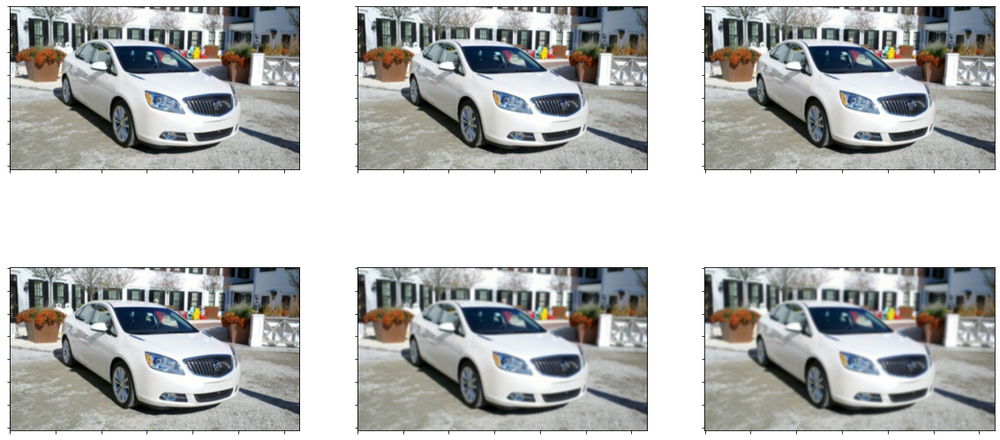

In [37]:
Visualizer(
    [
        transforms.GaussianBlur(3, sigma=2.0)(img),
        transforms.GaussianBlur(3, sigma=4.0)(img),
        transforms.GaussianBlur(3, sigma=8.0)(img),
        transforms.GaussianBlur(3, sigma=2.0)(img),
        transforms.GaussianBlur(7, sigma=2.0)(img),
        transforms.GaussianBlur(17, sigma=2.0)(img),
    ]
).visualize(figsize=(20, 10), cols=3, rows=2)

# Resize
```
Resize the input image to the given size.
    If the image is torch Tensor, it is expected
    to have [..., H, W] shape, where ... means an arbitrary number of leading dimensions
    Args:
        size (sequence or int): Desired output size. If size is a sequence like
            (h, w), output size will be matched to this. If size is an int,
            smaller edge of the image will be matched to this number.
            i.e, if height > width, then image will be rescaled to
            (size * height / width, size).
            In torchscript mode size as single int is not supported, use a sequence of length 1: ``[size, ]``.
        interpolation (InterpolationMode): Desired interpolation enum defined by
            :class:`torchvision.transforms.InterpolationMode`. Default is ``InterpolationMode.BILINEAR``.
            If input is Tensor, only ``InterpolationMode.NEAREST``, ``InterpolationMode.BILINEAR`` and
            ``InterpolationMode.BICUBIC`` are supported.
            For backward compatibility integer values (e.g. ``PIL.Image.NEAREST``) are still acceptable.
```

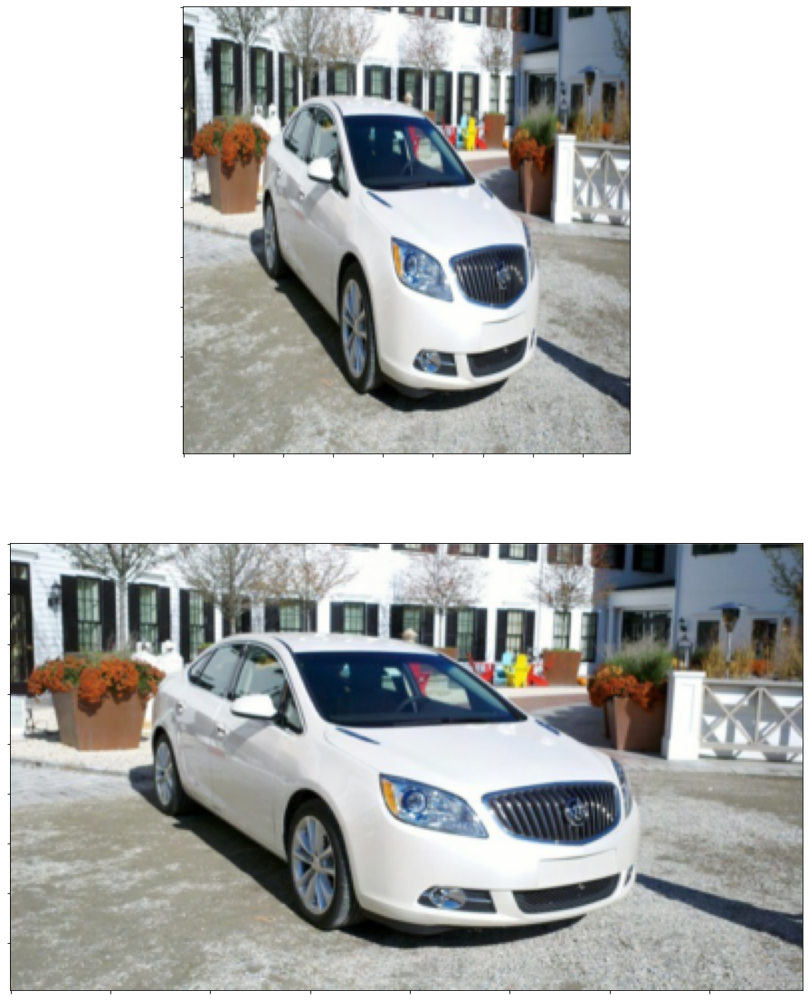

In [89]:
Visualizer(
    [
        transforms.Resize(224)(img),
        transforms.Resize((224, 224))(img),
    ]
).visualize(figsize=(20, 20), cols=1, rows=2)

In [ ]:
Visualizer(
    [
        transforms.Resize(224)(img),
        transforms.Resize((224, 224))(img),
    ]
).visualize(figsize=(20, 20), cols=1, rows=2)

# Random Erasing
_Random Erasing can only be done on `torch.Tensor` objects, not `PIL.Image`'s. This is why we convert the `img` to a `Tensor` before applying `RandomErasing`_

```
Randomly selects a rectangle region in an torch Tensor image and erases its pixels.
    This transform does not support PIL Image.
    'Random Erasing Data Augmentation' by Zhong et al. See https://arxiv.org/abs/1708.04896
    Args:
         p: probability that the random erasing operation will be performed.
         scale: range of proportion of erased area against input image.
         ratio: range of aspect ratio of erased area.
         value: erasing value. Default is 0. If a single int, it is used to
            erase all pixels. If a tuple of length 3, it is used to erase
            R, G, B channels respectively.
            If a str of 'random', erasing each pixel with random values.
         inplace: boolean to make this transform inplace. Default set to False.
    Returns:
        Erased Image.
```

### `scale` determines how large the patch is, `ratio` determines the aspect ratio of the patch

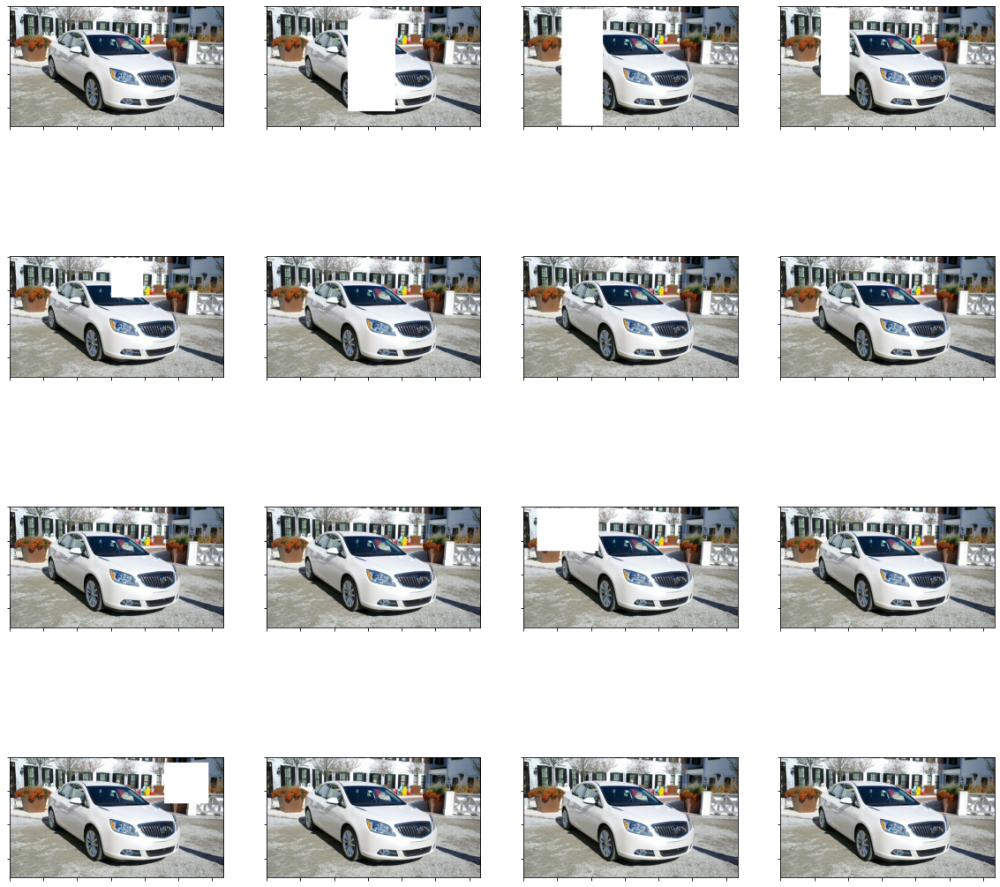

In [51]:
Visualizer(
    [img] * 20,
    image_extractor=lambda x: transforms.Compose([
        transforms.ToTensor(),
        transforms.RandomErasing(p=0.5, scale=(0.02, 0.33), ratio=(0.3, 3.3), value='ran', inplace=False),
        transforms.ToPILImage(),
    ])(x),
).visualize(figsize=(20, 20))